# 安装imgaug

```python
pip install git+https://github.com/aleju/imgaug
```
*****
项目地址：*https://github.com/aleju/imgaug*  
说明文档：*https://imgaug.readthedocs.io/en/latest/index.html*
*****

In [ ]:
# %pip install git+https://github.com/aleju/imgaug
# !git clone https://github.com/aleju/imgaug
# !cd ./imgaug
# !python setup.py install

In [1]:
import cv2
import math
import numpy as np
import matplotlib.pyplot as plt
import imgaug as ia
from imgaug import augmenters as iaa

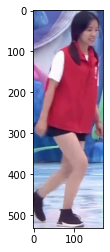

In [2]:
image = cv2.imread('./person/00059.jpg')
image = np.array(image[:,:,::-1], dtype=np.uint8)
plt.imshow(image)
plt.show()

## 图像旋转、平移、剪切

### 等比放大（加黑边）

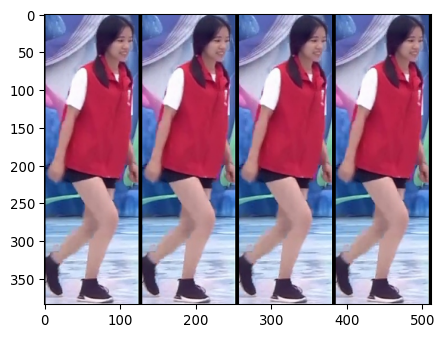

In [8]:
#等比放大
seq = iaa.OneOf([ 
    iaa.Sequential([
    iaa.PadToAspectRatio(0.333,position="center"),  #调整宽高比为1/3
    iaa.Resize({"height": 384, "width": 128}),
    ])])
example_images = np.array(
    [image for _ in range(4)],
    dtype=np.uint8
)
# aug_img = seq(images = image)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=4)

### 图像左右翻转

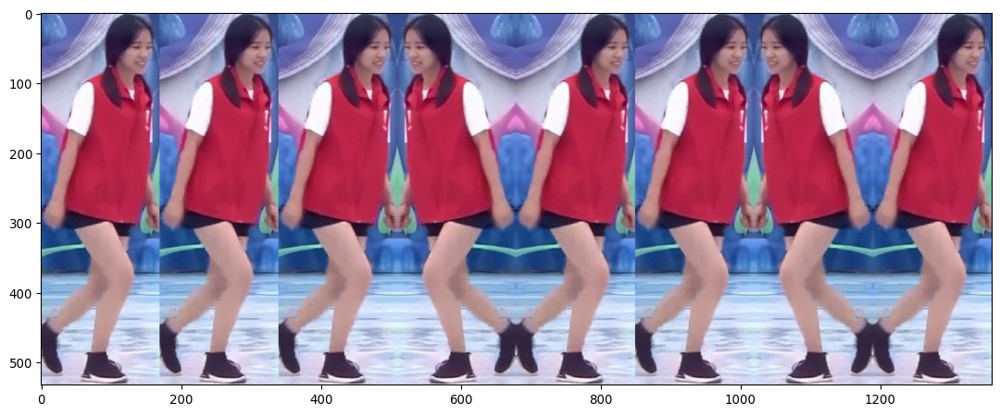

In [4]:
seq = iaa.OneOf([
    iaa.Fliplr(0.5),     #对百分之五十的图像进行做左右翻转
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 图片上下翻转

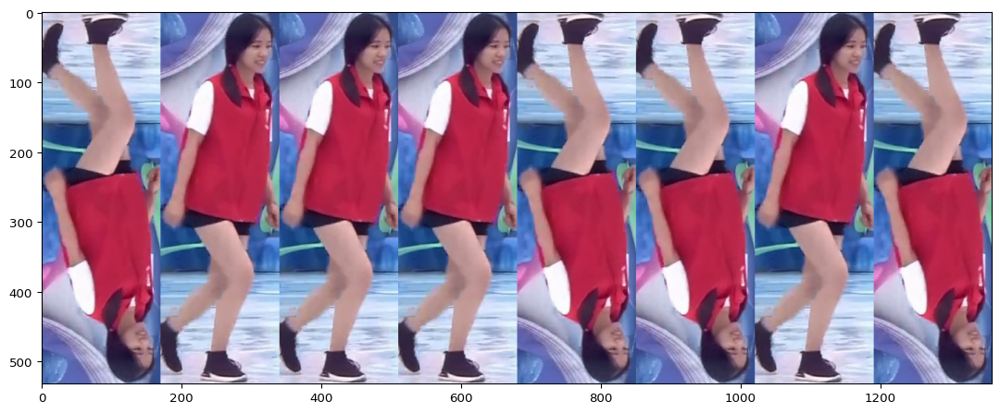

In [104]:
seq = iaa.OneOf([        
#     随机上下翻转
    iaa.Flipud(0.5)
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 图像缩放、平移、旋转、剪切操作

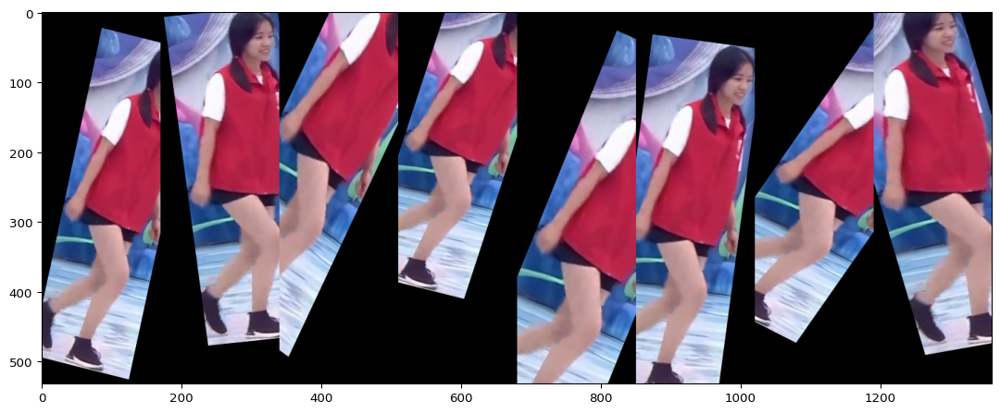

In [109]:
seq = iaa.OneOf([
        iaa.Affine(#组合变换
        #缩放变换
        scale={"x":(0.8,1.2),"y":(0.8,1.2)},
        #平移变换
        translate_percent={"x":(-0.2,0.2),"y":(-0.2,0.2)},
        #旋转
        rotate=(-25,25),
        #剪切
        shear=(-8,8)
    ) 
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 图片边缘随机裁剪

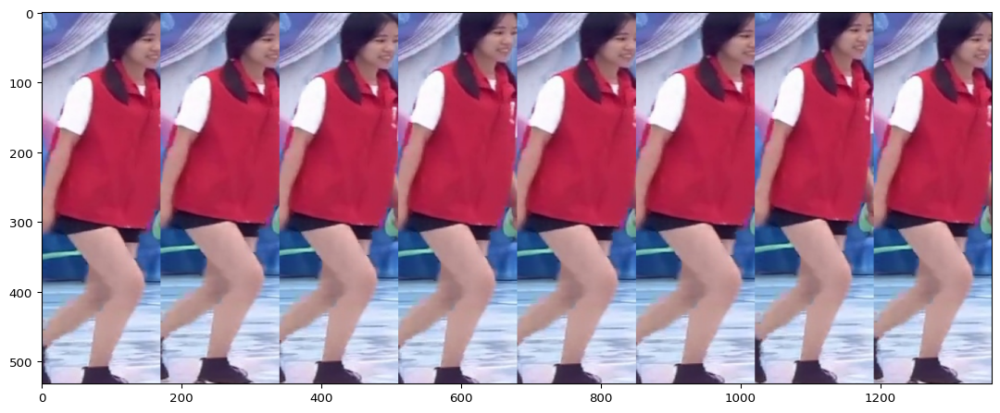

In [45]:
seq = iaa.OneOf([        
    # 从图片边随机裁剪10～25个像素,裁剪后图片的尺寸和之前一致
    iaa.Crop(px=(10,25),keep_size=True)
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 图片中央随机裁剪

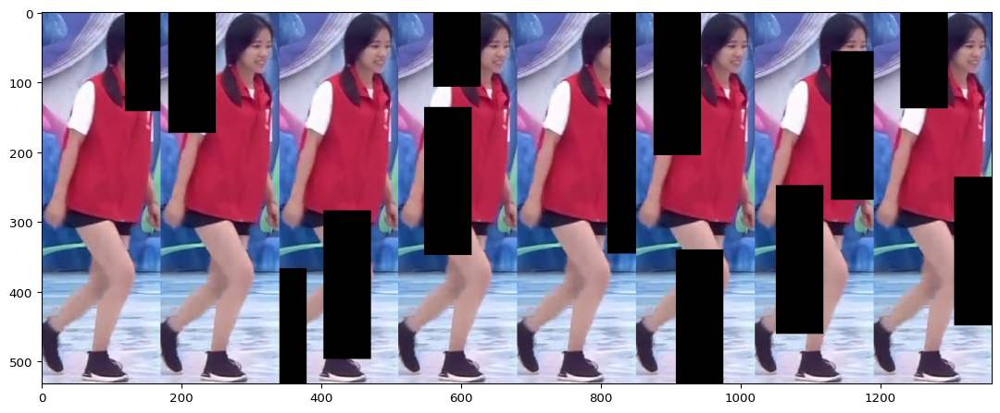

In [106]:
seq = iaa.OneOf([        
    # 在图片中裁剪1～3个矩形（用黑色填充），大小为图片大小的20%
    iaa.Cutout(nb_iterations=(1, 2), size=0.4, squared=False, fill_mode="constant", cval=0)
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

## 图像添加天气效果

### 云

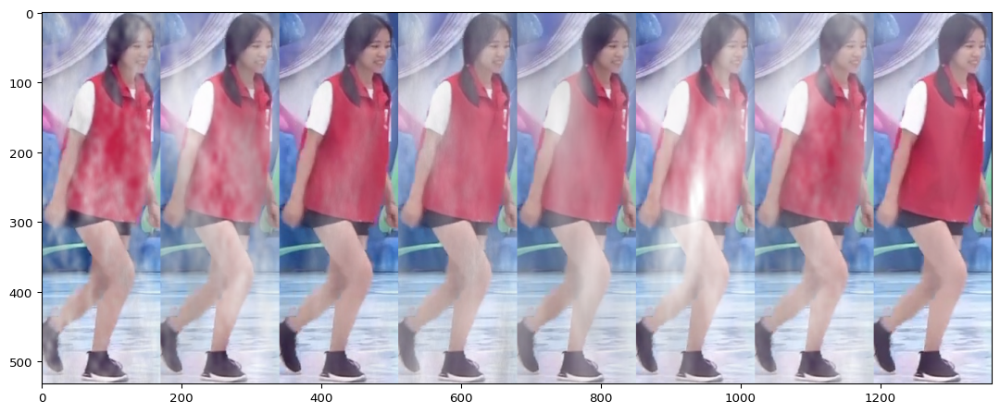

In [10]:
seq = iaa.OneOf([
    iaa.Clouds() #云
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 雾

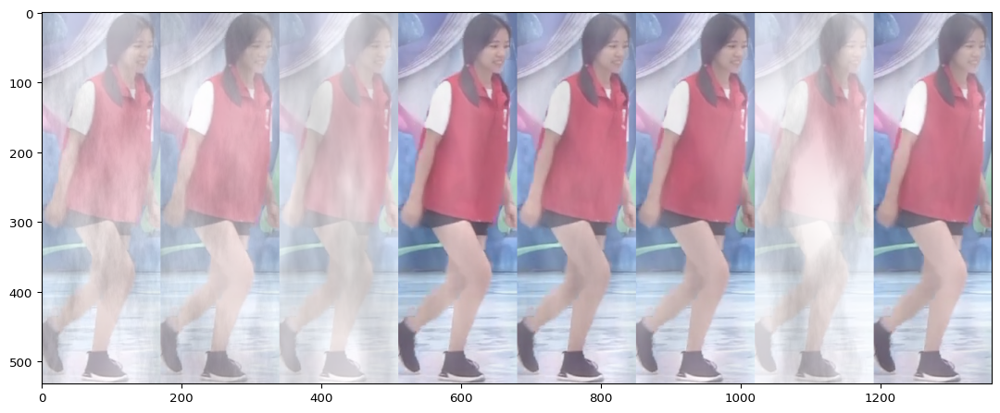

In [9]:
seq = iaa.OneOf([
    iaa.Fog() #雾气
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 雨

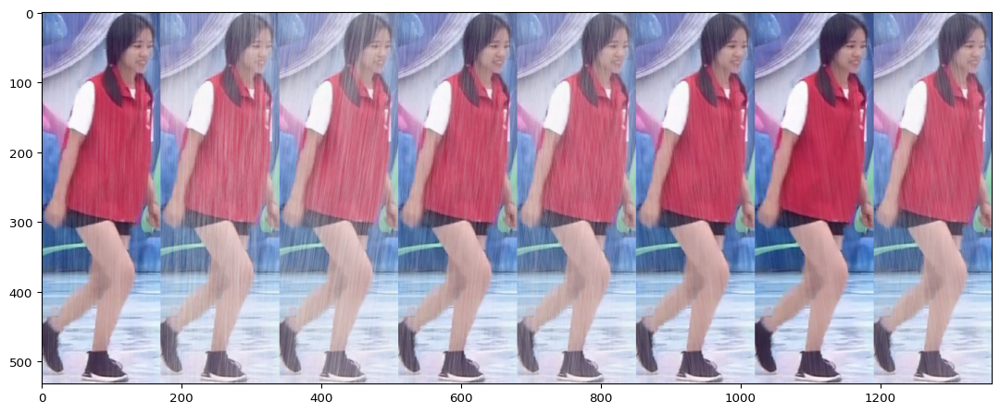

In [72]:
seq = iaa.OneOf([
    iaa.Rain(speed=(0.1, 0.3)) #下雨，雨速0.1～0.3

])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

## 图像扭曲、噪声、模糊

### 高斯噪声

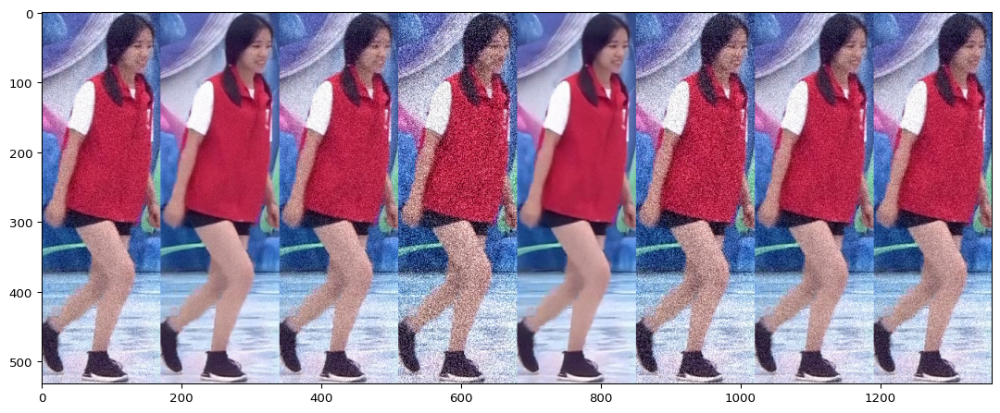

In [11]:
seq = iaa.OneOf([
    iaa.AdditiveGaussianNoise(scale=(0, 50))     #高斯噪声
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 拉普拉斯噪声

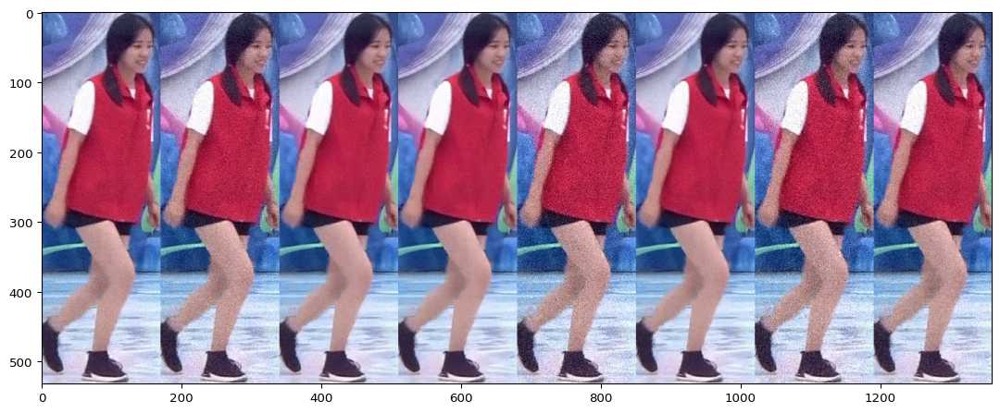

In [145]:
seq = iaa.OneOf([
    iaa.AdditiveLaplaceNoise(scale=(0, 0.05*255))     #拉普拉斯噪声
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 泊松噪声

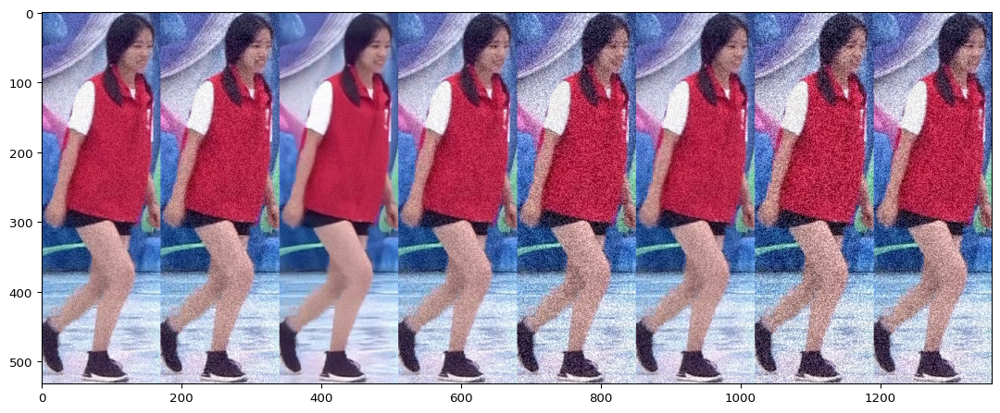

In [15]:
seq = iaa.OneOf([
    iaa.AdditivePoissonNoise((0, 40))     #泊松噪声
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 脉冲噪声

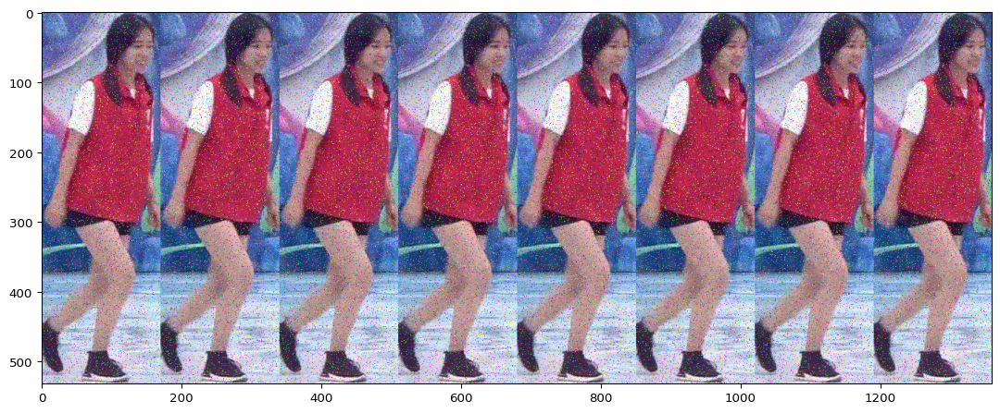

In [69]:
seq = iaa.OneOf([
    iaa.ImpulseNoise(0.1)     #脉冲噪声
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 椒盐噪声

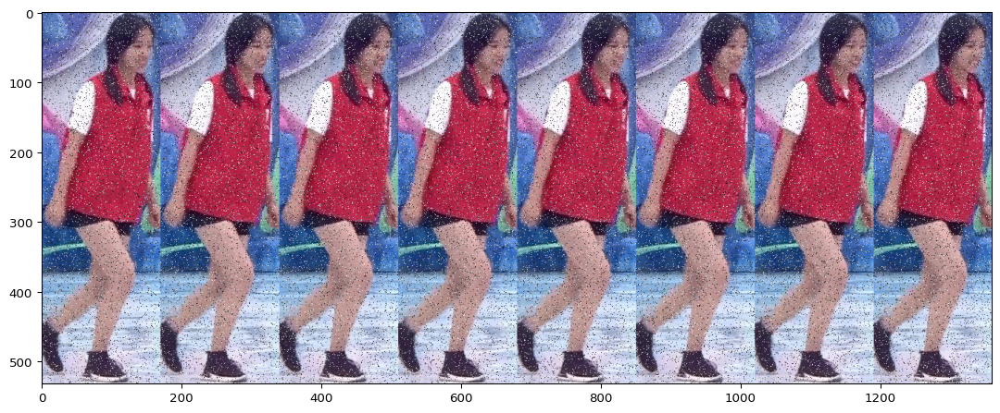

In [70]:
seq = iaa.OneOf([
    iaa.SaltAndPepper(0.1)     #椒盐噪声（盐为0，椒为255）
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 扭曲图像

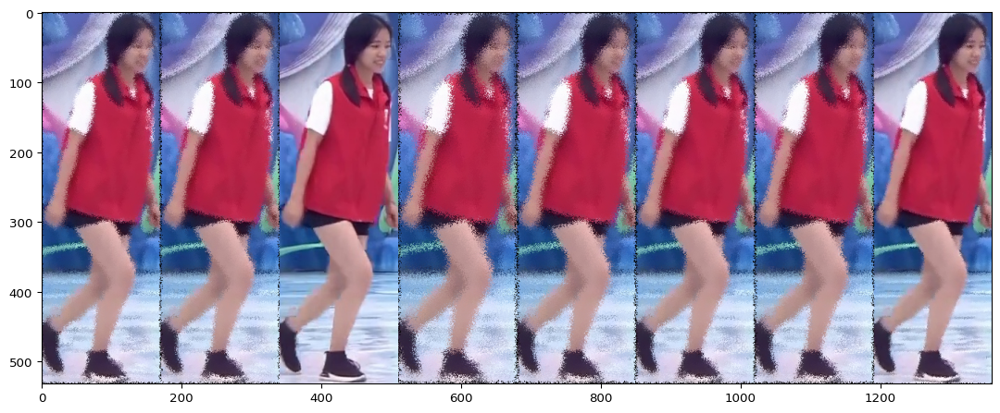

In [67]:
seq = iaa.OneOf([
    iaa.ElasticTransformation(alpha=(0, 5.0), sigma=0.25) #移动单个像素来局部扭曲图像
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 高斯模糊

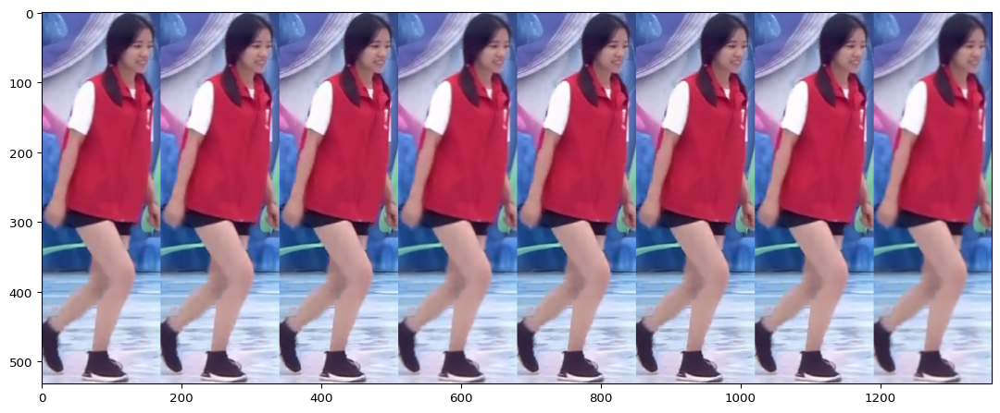

In [66]:
seq = iaa.OneOf([
    iaa.GaussianBlur((0, 1.0))     #在模型上使用0均值1方差进行高斯模糊
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 中值模糊

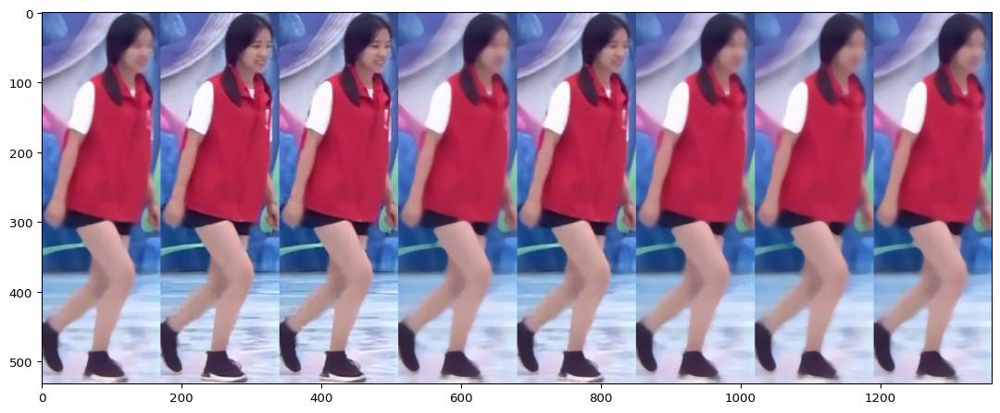

In [83]:
seq = iaa.OneOf([
    iaa.MedianBlur((1,13))     #在模型上使用中值模糊
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 平均模糊

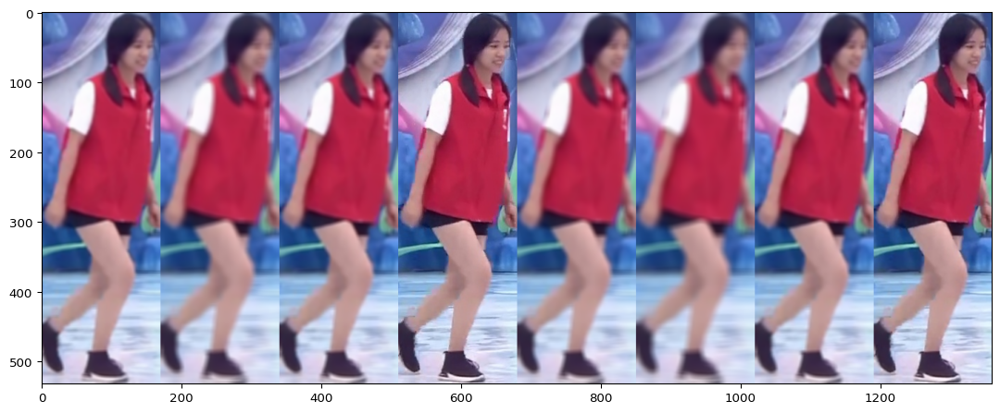

In [95]:
seq = iaa.OneOf([
    iaa.AverageBlur(k=(0, 11))     #在模型上使用平均模糊
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 双边模糊

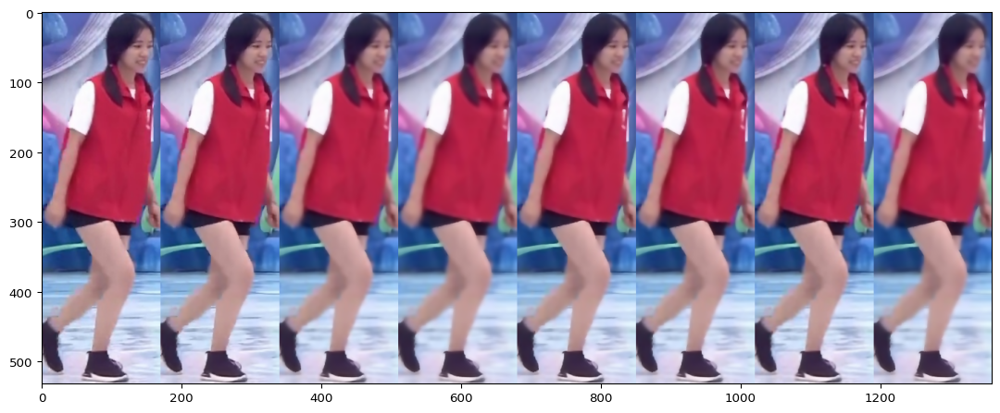

In [96]:
seq = iaa.OneOf([
    iaa.BilateralBlur(
    d=(3, 10), sigma_color=(10, 250), sigma_space=(10, 250))
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 运动模糊

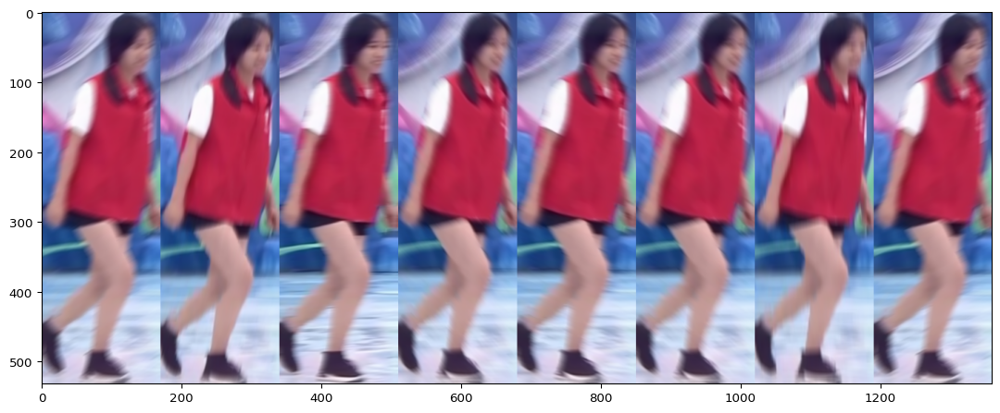

In [99]:
seq = iaa.OneOf([
    iaa.MotionBlur(k=15)
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 均值偏移模糊

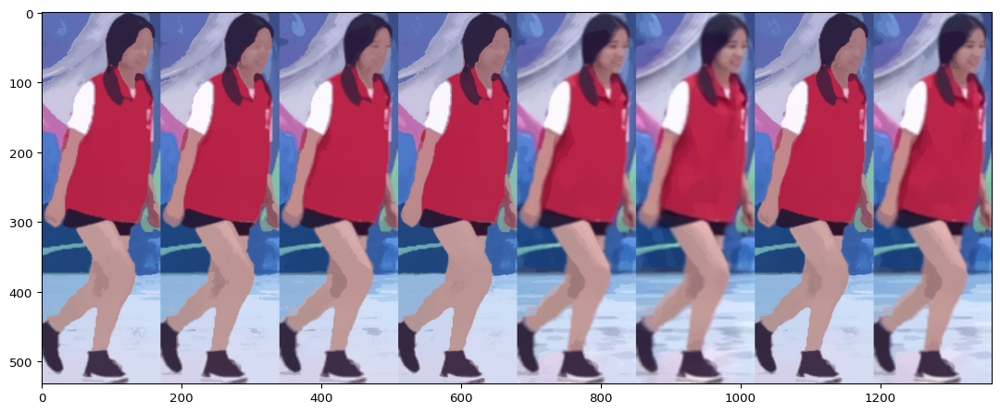

In [100]:
seq = iaa.OneOf([
    iaa.MeanShiftBlur()     #在模型上使用均值偏移模糊
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

## 图像色温、亮度、颜色

### 图像色温

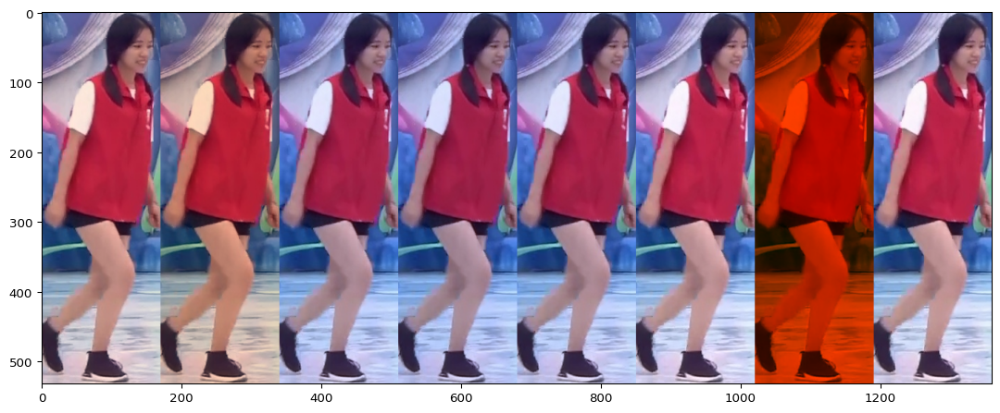

In [126]:
seq = iaa.OneOf([
    iaa.ChangeColorTemperature((1000, 9000))   #图像色温,1000为暖色，越大越冷
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 对比度(1)

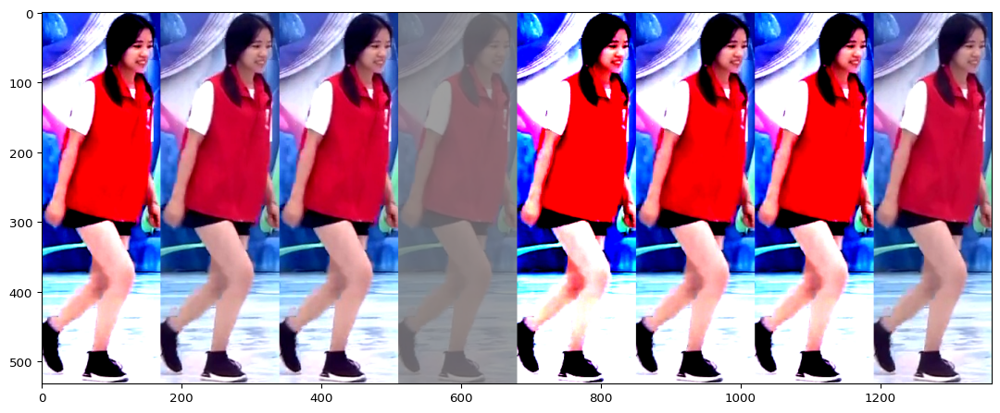

In [18]:
seq = iaa.OneOf([         #建立一个名为seq的实例，定义增强方法，用于增强
    iaa.ContrastNormalization(alpha=(0, 5))  #改变图像的对比度
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 对比度(2)

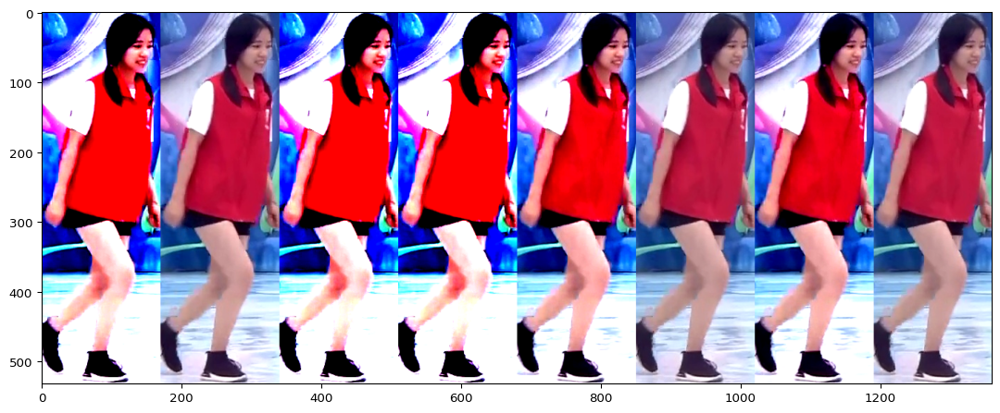

In [57]:
seq = iaa.OneOf([
    iaa.LinearContrast(alpha=(0.2,5))  #改变图像的对比度
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 转换图像色彩通道

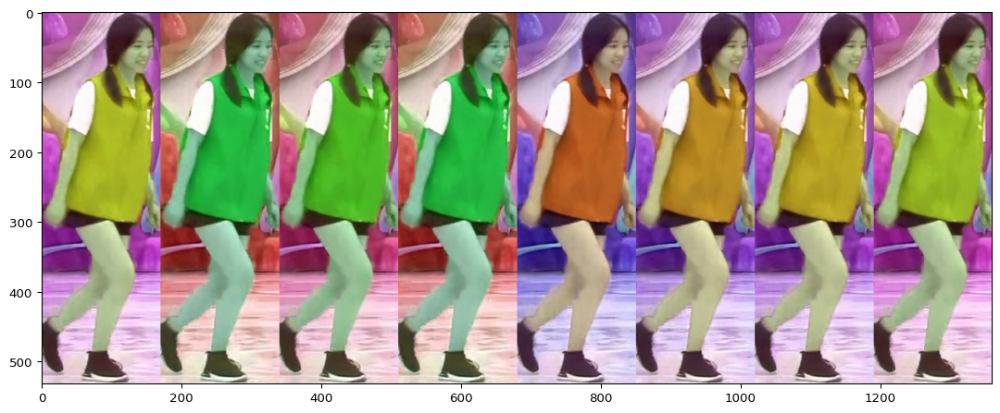

In [61]:
seq = iaa.OneOf([
    iaa.Sequential([
    iaa.ChangeColorspace(from_colorspace="RGB", to_colorspace="HSV"),
    iaa.WithChannels(0, iaa.Add((0, 100))),
    iaa.ChangeColorspace(from_colorspace="HSV", to_colorspace="RGB")
])])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 锐化

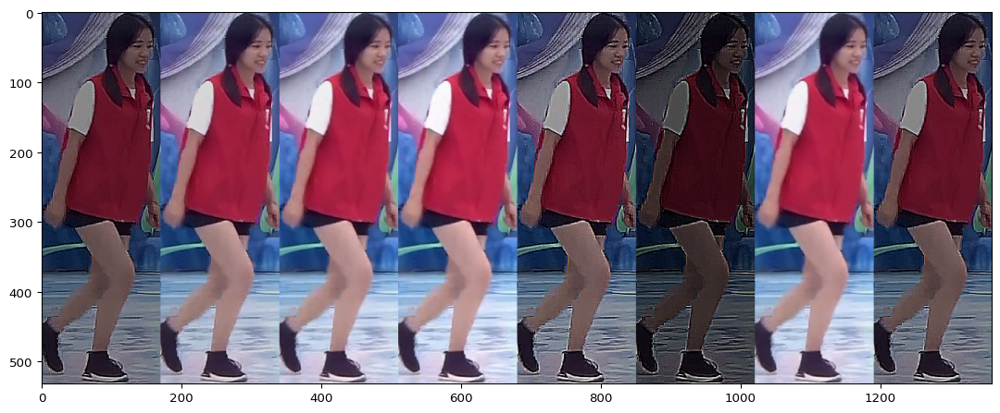

In [30]:
seq = iaa.OneOf([        
    # 锐化
    iaa.Sharpen(alpha=(0, 1), lightness=(0, 1))
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 边缘检测(1)

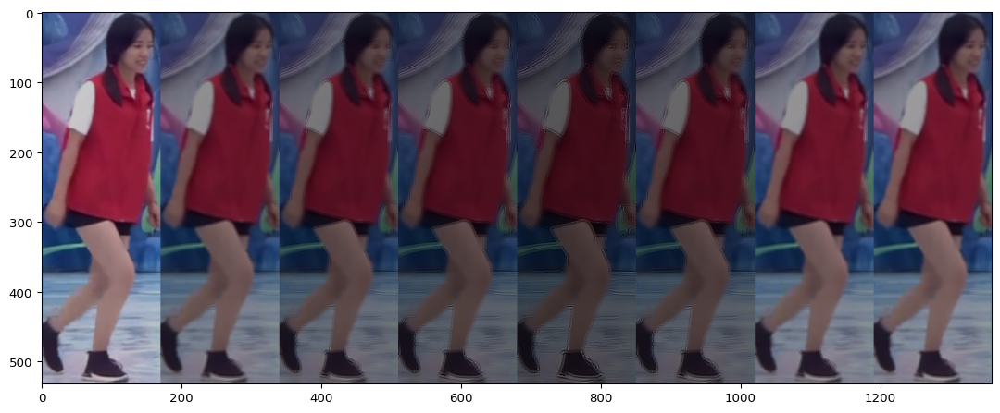

In [59]:
seq = iaa.OneOf([        
    # 边缘检测
    iaa.EdgeDetect(alpha=(0.2,0.8))
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 边缘检测(2)

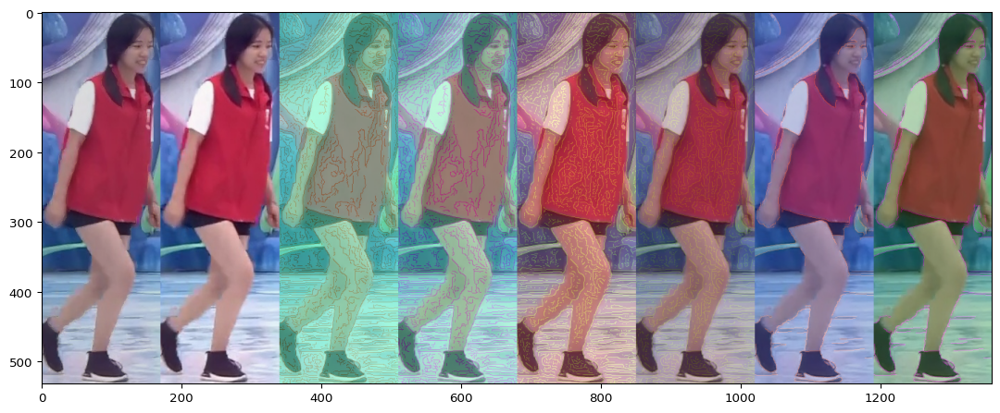

In [102]:
seq = iaa.OneOf([
    iaa.Canny(alpha=(0.0, 0.5))
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 浮雕效果

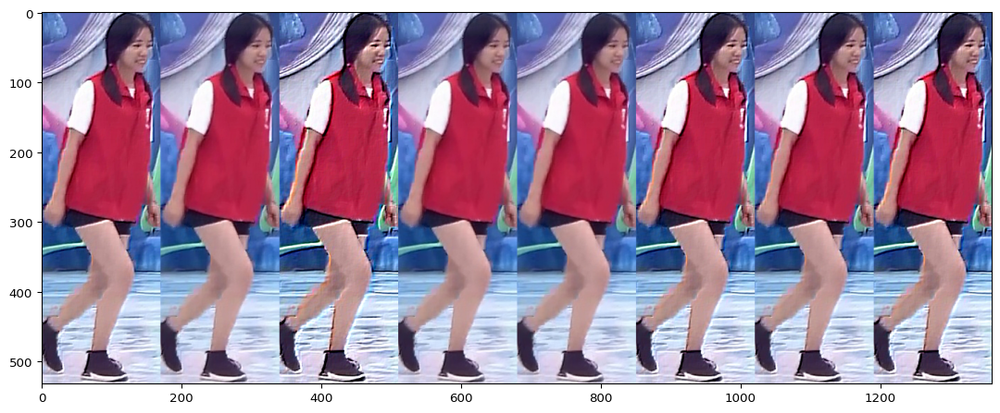

In [130]:
seq = iaa.OneOf([        
    # 浮雕效果
    iaa.Emboss(alpha=(0,1))
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 整体图像亮度

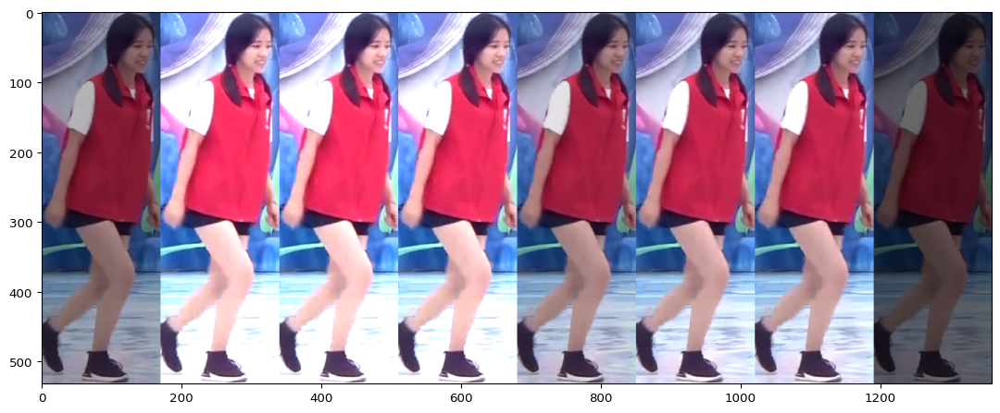

In [15]:
seq = iaa.OneOf([        
    iaa.Multiply(mul=(0.4,1.5)) # 明暗效果
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 按像素改变亮度

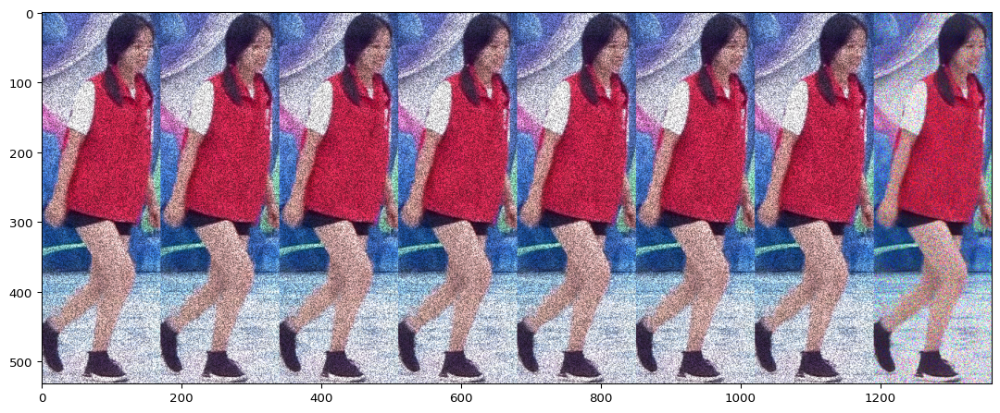

In [56]:
seq = iaa.OneOf([        
    # 按像素值改变明暗(将图像中10%的像素与 0.5 和 1.5 之间的随机值相乘)
    iaa.MultiplyElementwise(mul=(0.5,1.5), per_channel=0.1)
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 去除像素点（变为0）

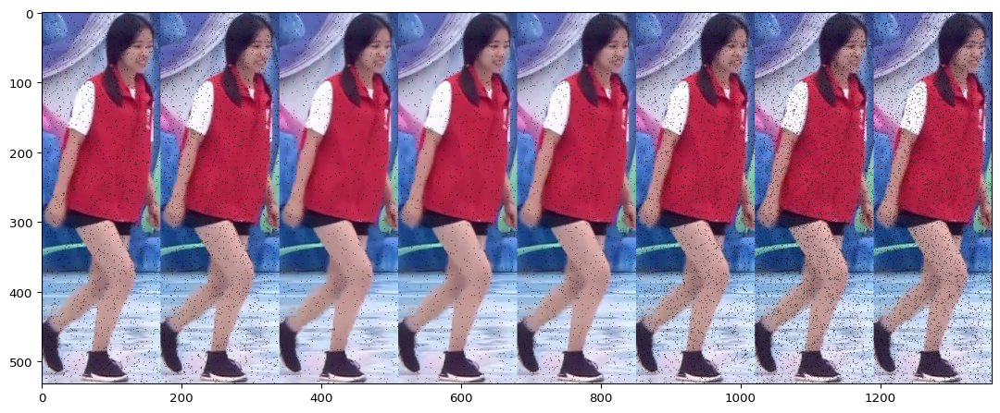

In [32]:
seq = iaa.OneOf([        
    # 0-0.05的范围随机去除像素值（变为0）
    iaa.Dropout(p=(0,0.05))
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 去除像素点（变为0）

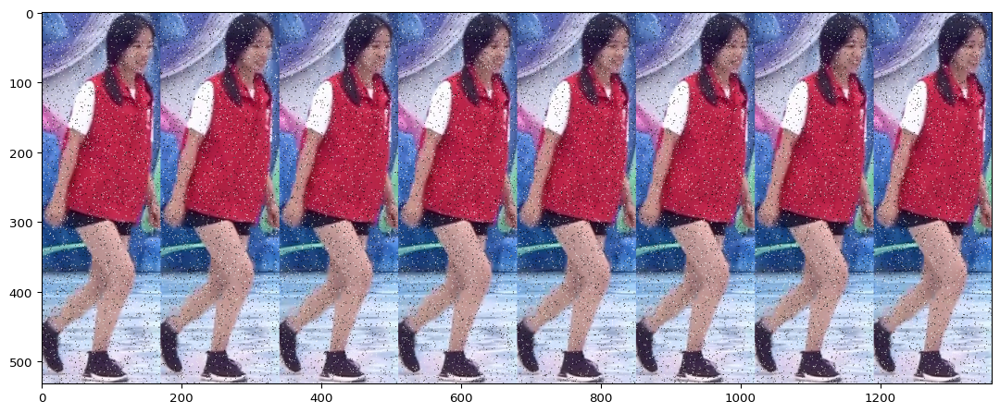

In [68]:
seq = iaa.OneOf([        
    # 5%的像素替换为0～255中的随机值
    iaa.ReplaceElementwise(0.05, [0, 255])
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 底片效果

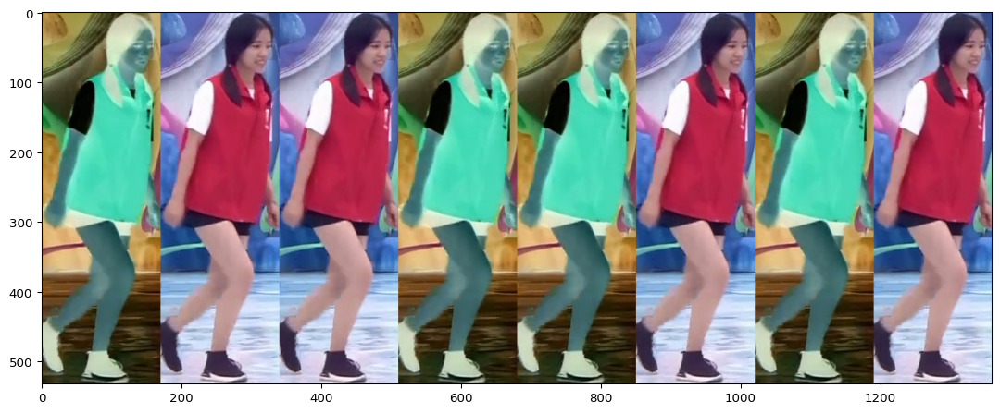

In [72]:
seq = iaa.OneOf([        
    iaa.Invert(p=0.5) #50%概率反转像素（像素i变为255-i）
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 通道删除

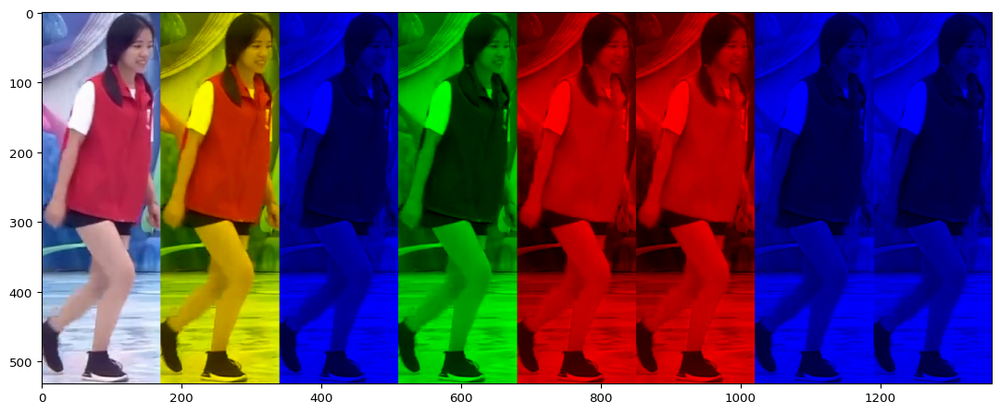

In [63]:
seq = iaa.OneOf([        
    iaa.Dropout2d(p=0.5) #随机删除一半颜色通道
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 卡通风格

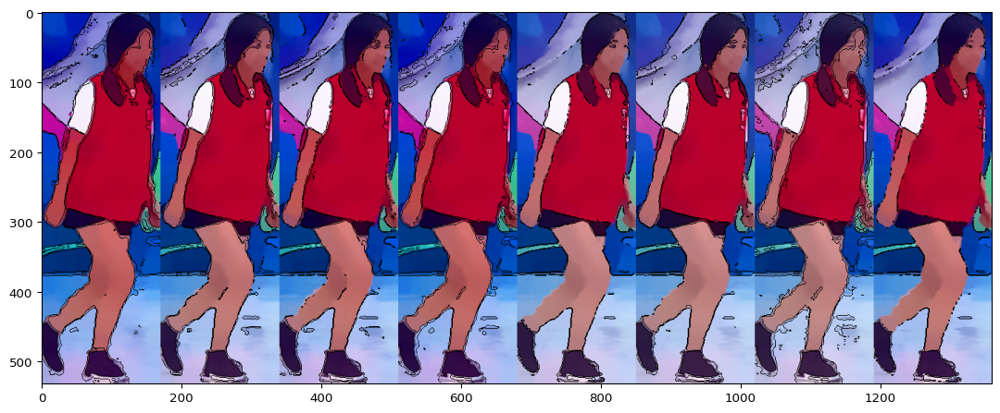

In [78]:
seq = iaa.OneOf([        
    iaa.Cartoon() #随机卡通增强，速度较慢
    ])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

### 随机与灰度图混合

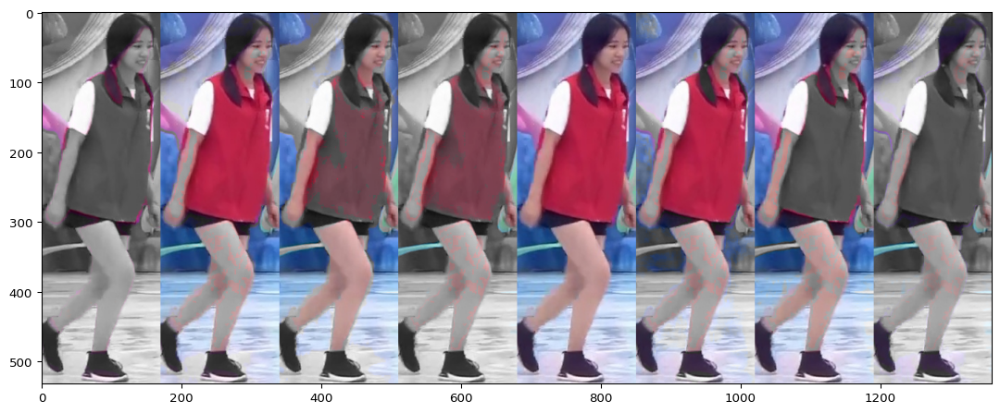

In [93]:
seq = iaa.OneOf([        
    iaa.BlendAlphaSomeColors(iaa.Grayscale(1.0))
])
example_images = np.array(
    [image for _ in range(8)],
    dtype=np.uint8
)
aug_imgs = seq(images = example_images)
#显示图片
ia.show_grid(aug_imgs,rows=1,cols=8)

# Example

In [154]:
def auto_aug(images):
    seq = iaa.Sequential([
        iaa.Sometimes(p=0.6,
                        then_list=iaa.Sequential([
                            iaa.PadToAspectRatio(0.333, position="center"),  # 调整宽高比为1/3
                            iaa.Resize({"height": 384, "width": 128}),
                            iaa.SomeOf((1, 3), [
                                iaa.OneOf([
                                    iaa.Fliplr(0.5),  # 对百分之五十的图像进行做左右翻转
                                    # 组合变换
                                    iaa.Affine(
                                        scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},  # 缩放变换
                                        translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},  # 平移变换
                                        rotate=(-25, 25),  # 旋转
                                        shear=(-8, 8)  # 剪切
                                    ),
                                    iaa.Crop(px=(10, 25), keep_size=True),  # 从图片边随机裁剪10～25个像素,裁剪后图片的尺寸和之前一致
                                    # 在图片中裁剪1～2个矩形（用黑色填充），大小为图片大小的40%
                                    iaa.Cutout(nb_iterations=(1, 2), size=0.4, squared=False, fill_mode="constant", cval=0)
                                ]),
                                iaa.OneOf([
                                    iaa.Clouds(),  # 云
                                    iaa.Fog(),  # 雾
                                    iaa.Rain(speed=(0.1, 0.3))  # 下雨，雨速0.1～0.3
                                    ]),
                                iaa.OneOf([
                                    iaa.AdditiveGaussianNoise(scale=(0, 50)),  # 高斯噪声
                                    iaa.AdditiveLaplaceNoise(scale=(0, 0.06 * 255)),  # 拉普拉斯噪声
                                    iaa.AdditivePoissonNoise((0, 40)),  # 泊松噪声
                                    iaa.ImpulseNoise(0.1),  # 脉冲噪声
                                    iaa.SaltAndPepper(0.1),  # 椒盐噪声（盐为0，椒为255）
                                ]),
                                iaa.OneOf([
                                    iaa.ElasticTransformation(alpha=(0, 5.0), sigma=0.25),  # 移动单个像素来局部扭曲图像
                                    iaa.MedianBlur((1, 13)),  # 中值模糊
                                    iaa.AverageBlur(k=(0, 11)),  # 平均模糊
                                    iaa.BilateralBlur(d=(3, 10), sigma_color=(10, 250), sigma_space=(10, 250)),  # 双边模糊
                                    iaa.MotionBlur(k=15),  # 运动模糊
                                    iaa.MeanShiftBlur()  # 均值偏移模糊
                                ]),
                                iaa.OneOf([
                                    iaa.ChangeColorTemperature((1000, 9000)),  # 图像色温,1000为暖色，越大越冷
                                    iaa.ContrastNormalization(alpha=(0, 5)),  # 改变图像的对比度1
                                    iaa.LinearContrast(alpha=(0.2, 5)),  # 改变图像的对比度2
                                    iaa.Sequential([  # 转换图像色彩通道
                                        iaa.ChangeColorspace(from_colorspace="RGB", to_colorspace="HSV"),
                                        iaa.WithChannels(0, iaa.Add((0, 100))),
                                        iaa.ChangeColorspace(from_colorspace="HSV", to_colorspace="RGB")
                                    ]),
                                    iaa.Sharpen(alpha=(0, 1), lightness=(0, 1)),  # 锐化
                                    iaa.EdgeDetect(alpha=(0.2, 0.8)),  # 边缘检测1
                                    iaa.Canny(alpha=(0.0, 0.5)),  # 边缘检测2
                                    iaa.Emboss(alpha=(0, 1)),  # 浮雕效果
                                    iaa.Multiply(mul=(0.4, 2)),  # 明暗效果
                                    # 按像素值改变明暗(将图像中10%的像素与 0.5 和 1.5 之间的随机值相乘)
                                    iaa.MultiplyElementwise(mul=(0.5, 1.5), per_channel=0.1),
                                    iaa.Dropout(p=(0, 0.05)),  # 0-0.05的范围随机去除像素值（变为0）
                                    iaa.ReplaceElementwise(0.05, [0, 255]),  # 5%的像素替换为0～255中的随机值
                                    iaa.Invert(p=0.5),  # 50%概率反转像素（像素i变为255-i）
                                    iaa.Dropout2d(p=0.5),  # 随机删除一半颜色通道
                                    iaa.BlendAlphaSomeColors(iaa.Grayscale(1.0))  #与灰度图混合
                                ]),
                                ])]),
                        else_list=iaa.Sequential([
                            iaa.PadToAspectRatio(0.333, position="center"),  # 调整宽高比为1/3
                            iaa.Resize({"height": 384, "width": 128})
                        ])
                        ),
                        iaa.SaveDebugImageEveryNBatches('./', 1)]) #每1个batch保存一张图片在当前目录
    aug_imgs = seq(images=images)
    return aug_imgs

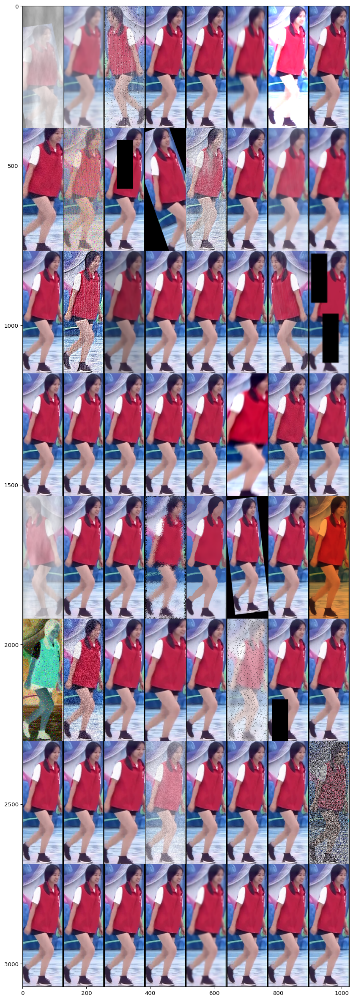

In [155]:
example_images = np.array(
    [image for _ in range(64)],
    dtype=np.uint8
)
aug_imgs = auto_aug(example_images)
#显示图片
ia.show_grid(aug_imgs,rows=8,cols=8)